# CZ4042 Project: Image colourisation

Hello! Our selected problem for the Neural Network Group Project is Image Colourisation. The problem is given simply as follows: Given black & white photos, produce coloured versions of the same photos that matches reality as much as possible.

This is not a new problem, but is challenging and interesting for deep learning beginners like us. In our learning journey, we will attempt to develop a Deep Learning Solution from scratch (with help from research and online references of course) and hopefully churn out a model that can accurately colourise grayscale images.

The datasets and references will be included in this notebook for completeness.

Our dataset is extracted from the following Kaggle Link, it includes both grayscale and coloured images of some 7000+ landscapes.
https://www.kaggle.com/datasets/theblackmamba31/landscape-image-colorization

We referenced key inspiration and took notes from a bunch of papers and online data science articles:
- (what we used): (link here)
- Image Colourising Tutorial : https://towardsdatascience.com/colorizing-black-white-images-with-u-net-and-conditional-gan-a-tutorial-81b2df111cd8

#### Image loading and preprocessing

In [58]:
import os
from tqdm import tqdm
import torch
import numpy as np
from PIL import Image
from torchvision import transforms, io
import torch.nn.functional as F
import matplotlib.pyplot as plt
import random

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
# USAGE: tensor_on_gpu = your_tensor.to(device)

In [59]:
SIZE = 256
SAMPLE = 2000

notebook_path = os.path.dirname(os.path.abspath("__file__"))
data_path = os.path.join(notebook_path, "Dataset")
color_path = os.path.join(data_path, "color")
gray_path = os.path.join(data_path, "gray")

print(notebook_path)
print(data_path)
print(color_path)
print(gray_path)

color_files = os.listdir(color_path)
gray_files = os.listdir(gray_path)

c:\Users\chuag\OneDrive - Nanyang Technological University\Desktop\BCG 4.1\CZ4042\assignment\project
c:\Users\chuag\OneDrive - Nanyang Technological University\Desktop\BCG 4.1\CZ4042\assignment\project\Dataset
c:\Users\chuag\OneDrive - Nanyang Technological University\Desktop\BCG 4.1\CZ4042\assignment\project\Dataset\color
c:\Users\chuag\OneDrive - Nanyang Technological University\Desktop\BCG 4.1\CZ4042\assignment\project\Dataset\gray


In [60]:
from skimage.color import rgb2lab, lab2rgb

random_index = np.random.choice(range(0, len(color_files)), SAMPLE, replace=False) # choosing random indexes to select images

L_images = []
ab_images = []

for i in tqdm(random_index):
    img_path = os.path.join(color_path, color_files[i])
    image = io.read_image(img_path)
    image = image.unsqueeze(0)
    image = F.interpolate(image,(SIZE,SIZE))
    image = image.squeeze(0)
    # image = image.permute(1,2,0)
    # image = image.repeat(1,1,3)
    # image = image.permute(2,0,1)
    
    image = torch.tensor(rgb2lab(image.permute(1,2,0)/255))

    image = (image + torch.tensor([0, 128, 128])) / torch.tensor([100, 255, 255])
    image = image.permute(2,0,1)

    #Use L channel from image to predict a,b channels of label
    L = image[:1,:,:] # L channels
    ab = image[1:,:,:] # a, b channels

    L_images.append(L)
    ab_images.append(ab)


100%|██████████| 2000/2000 [00:29<00:00, 68.85it/s]


In [61]:
L_images[0].shape

torch.Size([1, 256, 256])

In [62]:
ab_images[0].shape

torch.Size([2, 256, 256])

In [63]:
from torch.utils.data import Dataset, DataLoader

split_ratio = 0.7

split = int(split_ratio * SAMPLE)

class dataset(Dataset):
    def __init__(self, X, Y):
        self.L = torch.stack(X) # L features
        self.ab = torch.stack(Y) # a*b features
    
    def __len__(self):
        return len(self.L)
    
    def __getitem__(self, index):
        return self.L[index], self.ab[index]
    

# Assuming color_img_tensor and gray_img_tensor are PyTorch tensors
trainset = dataset(L_images[:split], ab_images[:split])
testset = dataset(L_images[split:], ab_images[split:])

In [64]:
batch_size = 16

In [65]:
split

1400

In [66]:
train_loader = DataLoader(trainset, batch_size = batch_size, shuffle = True)
test_loader = DataLoader(testset, batch_size = batch_size, shuffle = True)

In [67]:
# Get the first batch (or example)
L_images, ab_images = next(iter(train_loader))

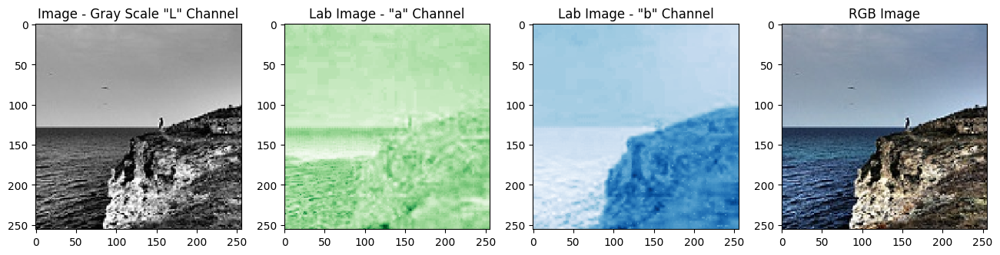

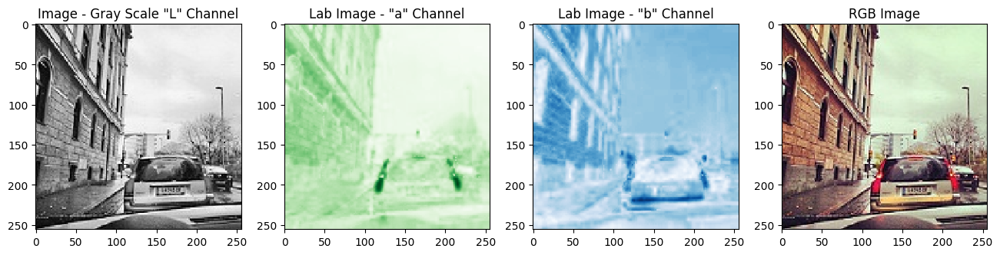

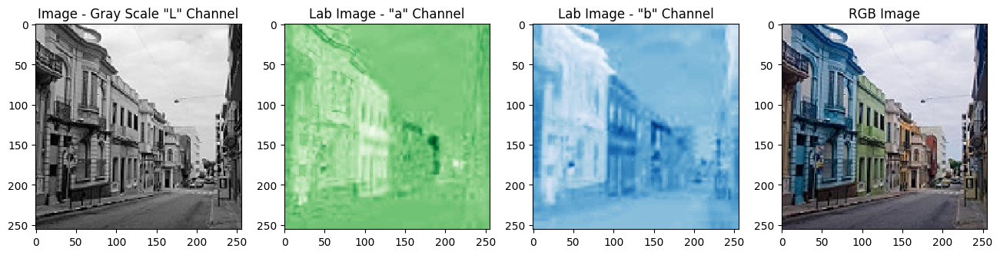

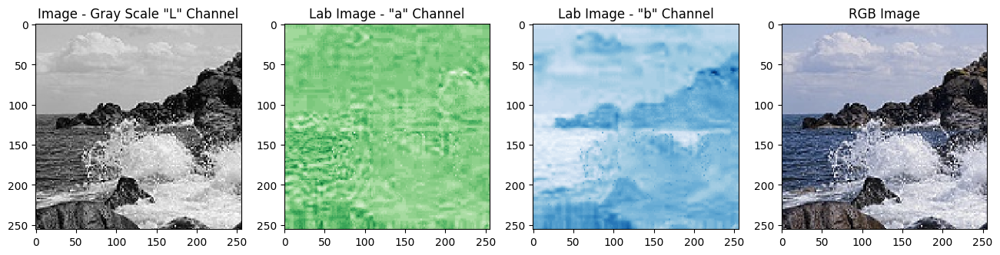

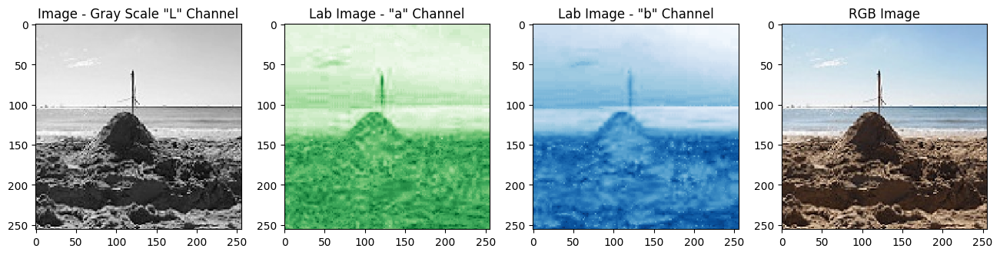

In [68]:
def plot_images(no_show = 5):

    for i in range(no_show):
    
        fig = plt.figure(figsize=(16,16))
        plt.subplot(441)
        plt.imshow(L_images[i].permute(1,2,0),cmap='gray')
        plt.title('Image - Gray Scale "L" Channel')
        plt.subplot(442)
        plt.imshow(ab_images[i].permute(1,2,0)[:,:,0],cmap='Greens')
        plt.title('Lab Image - "a" Channel')

        plt.subplot(443)
        plt.imshow(ab_images[i].permute(1,2,0)[:,:,1],cmap='Blues')
        plt.title('Lab Image - "b" Channel')

        plt.subplot(444)
        color_image = torch.cat((L_images[i], ab_images[i]),dim=0).permute(1,2,0)
        color_image = color_image * torch.tensor([100,255,255]) -torch.tensor([0,128,128])
        color_image = lab2rgb(color_image)
        plt.imshow(color_image)
        plt.title('RGB Image')
        plt.show()

plot_images(5)

In [69]:
import torch.nn as nn

class downsample(nn.Module):
    def __init__(self, in_channels, out_channels, kernel_size, apply_batchnorm=True):
        super(downsample, self).__init__()
        
        stride = 2
        padding = 0
        padding = (kernel_size - stride) // 2
    
        self.conv = nn.Conv2d(in_channels, out_channels, kernel_size, stride=stride, padding=padding, bias=False)
        self.batchnorm = nn.BatchNorm2d(out_channels) if apply_batchnorm else None
        self.leaky_relu = nn.LeakyReLU()

    def forward(self, x):
        x = self.conv(x)
        if self.batchnorm:
            x = self.batchnorm(x)
        x = self.leaky_relu(x)
        return x
    
class upsample(nn.Module):
    def __init__(self, in_channels, out_channels, kernel_size, apply_dropout=False):
        super(upsample, self).__init__()

        stride = 2
        padding = 0
        padding = (kernel_size - stride) // 2
        

        self.conv_transpose = nn.ConvTranspose2d(in_channels, out_channels, kernel_size, stride=stride, padding=padding, bias=False)
        self.batchnorm = nn.BatchNorm2d(out_channels)
        self.dropout = nn.Dropout(0.5) if apply_dropout else None
        self.relu = nn.ReLU()

    def forward(self, x):
        x = self.conv_transpose(x)
        x = self.batchnorm(x)
        if self.dropout:
            x = self.dropout(x)
        x = self.relu(x)
        return x

In [70]:
class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()

        # kernel size
        ks = 4

        # Define the layers for downsampling
        self.down_stack = nn.ModuleList([
            downsample(1, 64, ks, apply_batchnorm=False), # 1 L channel input
            downsample(64, 128, ks),
            downsample(128, 256, ks),
            downsample(256, 512, ks),
            downsample(512, 512, ks),
            downsample(512, 512, ks),
            downsample(512, 512, ks),
            downsample(512, 512, ks),
        ])

        # Define the layers for upsampling
        self.up_stack = nn.ModuleList([
            upsample(512, 512, ks, apply_dropout=True),
            upsample(1024, 512, ks, apply_dropout=True),
            upsample(1024, 512, ks, apply_dropout=True),
            upsample(1024, 512, ks),
            upsample(1024, 256, ks),
            upsample(512, 128, ks),
            upsample(256, 64, ks),
        ])

        # Define the final layer
        self.last = nn.ConvTranspose2d(128, 2, kernel_size=4, stride=2, padding=1) # ab channel output
        self.tanh = nn.Tanh() # activation function

    def forward(self, x):
        # Downsampling through the model
        skips = []
        for down in self.down_stack:
            x = down(x)
            skips.append(x)

        skips = reversed(skips[:-1])

        # Upsampling and establishing the skip connections
        for up, skip in zip(self.up_stack, skips):
            x = up(x)
            x = torch.cat([x, skip], dim=1)

        x = self.last(x)
        x = self.tanh(x)

        return x

# Example usage:
# generator = Generator()
# inputs = torch.randn(1, 3, 256, 256)  # Example input tensor
# outputs = generator(inputs)

In [71]:
class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()

        #initializer = torch.nn.init.normal_

        # Define input layers
        self.conv1 = downsample(3, 64, kernel_size=4, apply_batchnorm=False) # 1 input channel (L) + 2 target channel (ab)
        self.conv2 = downsample(64, 128, kernel_size=4)
        self.conv3 = downsample(128, 256, kernel_size=4)

        # Zero-padding layer
        self.zero_pad1 = nn.ZeroPad2d(1)

        # Convolutional layer with 512 channels
        self.conv4 = nn.Conv2d(256, 512, kernel_size=4, stride=1,
                               padding=0, bias=False)

        # Batch normalization layer
        self.batchnorm1 = nn.BatchNorm2d(512)

        # LeakyReLU activation
        self.leaky_relu = nn.LeakyReLU(0.2)

        # Zero-padding layer
        self.zero_pad2 = nn.ZeroPad2d(1)

        # Convolutional layer with 1 channel (output)
        self.last = nn.Conv2d(512, 1, kernel_size=4, stride=1, padding=0)

    def forward(self, inp, tar):
        # Concatenate input and target images along the channel dimension
        x = torch.cat((inp, tar), dim=1)

        # Downsample layers
        x = self.conv1(x)
        x = self.conv2(x)
        x = self.conv3(x)

        # Zero-padding, convolution, batch normalization, and LeakyReLU
        x = self.zero_pad1(x)
        x = self.conv4(x)
        x = self.batchnorm1(x)
        x = self.leaky_relu(x)

        # Zero-padding and final convolution for output
        x = self.zero_pad2(x)
        x = self.last(x)

        return x

# Example usage:
# discriminator = Discriminator()
# inp = torch.randn(1, 3, 256, 256)  # Example input tensor
# tar = torch.randn(1, 3, 256, 256)  # Example target tensor
# output = discriminator(inp, tar)

In [72]:
from torchsummary import summary

generator = Generator()
generator.to(device)
summary(generator, (1, SIZE, SIZE), batch_size=batch_size)

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [16, 64, 128, 128]           1,024
         LeakyReLU-2         [16, 64, 128, 128]               0
        downsample-3         [16, 64, 128, 128]               0
            Conv2d-4          [16, 128, 64, 64]         131,072
       BatchNorm2d-5          [16, 128, 64, 64]             256
         LeakyReLU-6          [16, 128, 64, 64]               0
        downsample-7          [16, 128, 64, 64]               0
            Conv2d-8          [16, 256, 32, 32]         524,288
       BatchNorm2d-9          [16, 256, 32, 32]             512
        LeakyReLU-10          [16, 256, 32, 32]               0
       downsample-11          [16, 256, 32, 32]               0
           Conv2d-12          [16, 512, 16, 16]       2,097,152
      BatchNorm2d-13          [16, 512, 16, 16]           1,024
        LeakyReLU-14          [16, 512,

In [73]:
discriminator = Discriminator()
discriminator.to(device)
summary(discriminator, [(1, SIZE, SIZE),(2, SIZE, SIZE)], batch_size=batch_size)

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [16, 64, 128, 128]           3,072
         LeakyReLU-2         [16, 64, 128, 128]               0
        downsample-3         [16, 64, 128, 128]               0
            Conv2d-4          [16, 128, 64, 64]         131,072
       BatchNorm2d-5          [16, 128, 64, 64]             256
         LeakyReLU-6          [16, 128, 64, 64]               0
        downsample-7          [16, 128, 64, 64]               0
            Conv2d-8          [16, 256, 32, 32]         524,288
       BatchNorm2d-9          [16, 256, 32, 32]             512
        LeakyReLU-10          [16, 256, 32, 32]               0
       downsample-11          [16, 256, 32, 32]               0
        ZeroPad2d-12          [16, 256, 34, 34]               0
           Conv2d-13          [16, 512, 31, 31]       2,097,152
      BatchNorm2d-14          [16, 512,

In [74]:
import torch.nn.functional as F
import torch.optim as optim

gen_loss_object = torch.nn.BCEWithLogitsLoss()
disc_loss_object = torch.nn.BCEWithLogitsLoss()
generator_optimizer = optim.Adam(generator.parameters(), lr=2e-4, betas=(0.5, 0.999))
discriminator_optimizer = optim.Adam(discriminator.parameters(), lr=2e-4, betas=(0.5, 0.999))

LAMBDA = 100

def generator_loss(disc_generated_output, gen_output, target):
    gan_loss = gen_loss_object(disc_generated_output, torch.ones_like(disc_generated_output))

    # mean absolute error
    l1_loss = F.l1_loss(gen_output, target)

    total_gen_loss = gan_loss + (LAMBDA * l1_loss)

    return total_gen_loss, gan_loss, l1_loss

def discriminator_loss(disc_real_output, disc_generated_output):
    real_loss = disc_loss_object(disc_real_output, torch.ones_like(disc_real_output))

    generated_loss = disc_loss_object(disc_generated_output, torch.zeros_like(disc_generated_output))

    total_disc_loss = real_loss + generated_loss

    return total_disc_loss

In [75]:
def train_step(input_image, target, epoch):
    # Set the generator and discriminator to training mode
    generator.train()
    discriminator.train()

    # Move tensors to the appropriate device (e.g., GPU)
    input_image, target = input_image.to(device), target.to(device)

    # Generator forward pass to generate fake images
    gen_output = generator(input_image)

    # Discriminator forward pass with real images
    disc_real_output = F.sigmoid(discriminator(input_image, target))

    # Discriminator forward pass with fake images (detach gen_output to prevent gradient flow to generator)
    disc_generated_output = F.sigmoid(discriminator(input_image, gen_output.detach()))

    # Calculate the generator loss, including GAN loss and L1 loss
    gen_total_loss, gen_gan_loss, gen_l1_loss = generator_loss(disc_generated_output, gen_output, target)

    # Zero gradients for the generator optimizer
    generator_optimizer.zero_grad()
    
    # Backward pass for the generator
    gen_total_loss.backward(retain_graph=True)
    
    # Update weights for the generator
    generator_optimizer.step()

    # Calculate the discriminator loss
    disc_loss = discriminator_loss(disc_real_output, disc_generated_output)

    # Zero gradients for the discriminator optimizer
    discriminator_optimizer.zero_grad()

    # Backward pass for the discriminator
    disc_loss.backward()
    
    # Update weights for the discriminator
    discriminator_optimizer.step()

    return gen_total_loss, gen_gan_loss, gen_l1_loss, disc_loss

In [76]:
import time

def fit(train_ds, epochs):
    
    for epoch in range(epochs):
        start = time.time()

        gen_total_loss_sum = 0
        disc_loss_sum = 0
        num_batches = 0

        print("Epoch: ", epoch+1)

        # Train
        for n, (input_image, target) in tqdm(enumerate(train_ds), total=len(train_ds)):
            gen_total_loss, gen_gan_loss, gen_l1_loss, disc_loss = train_step(input_image, target, epoch)

            gen_total_loss_sum += gen_total_loss.item()
            disc_loss_sum += disc_loss.item()
            num_batches += 1

        # Print average losses
        gen_total_loss_avg = gen_total_loss_sum / num_batches
        disc_loss_avg = disc_loss_sum / num_batches
        print(f'Generator total loss: {gen_total_loss_avg}')
        print(f'Discriminator loss: {disc_loss_avg}')

        print ('Time taken for epoch {} is {} sec\n'.format(epoch + 1, time.time()-start))

torch.Size([16, 1, 256, 256]) torch.Size([16, 2, 256, 256])


<Figure size 1500x1500 with 0 Axes>

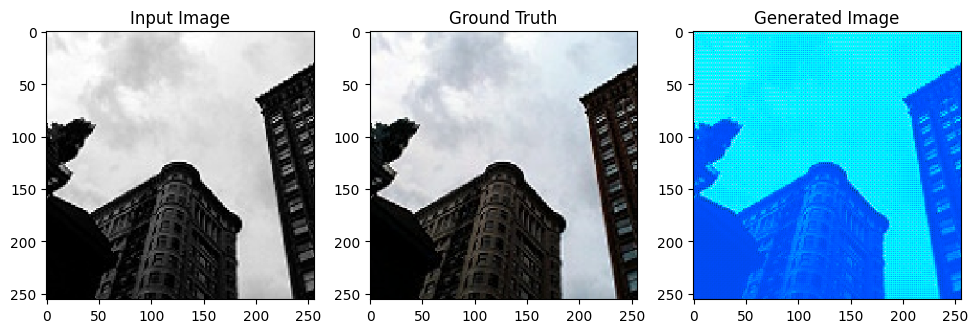

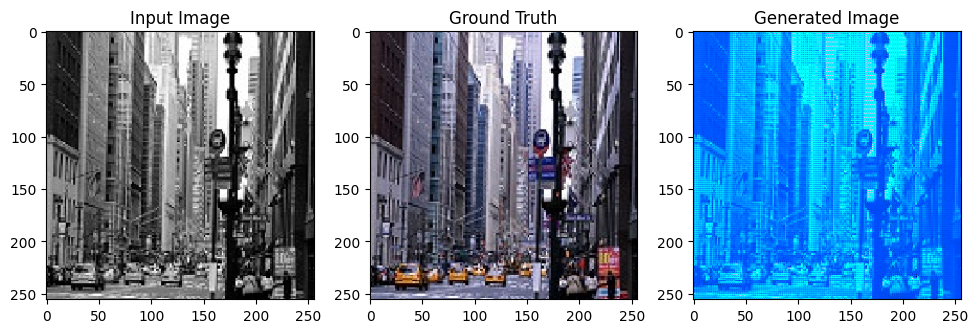

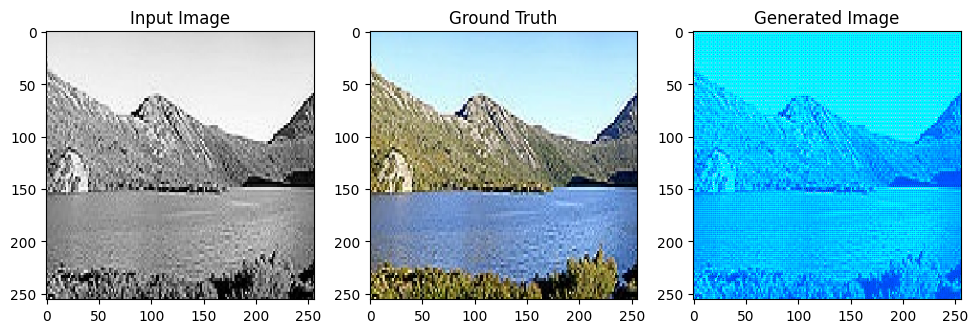

torch.Size([16, 1, 256, 256]) torch.Size([16, 2, 256, 256])


<Figure size 1500x1500 with 0 Axes>

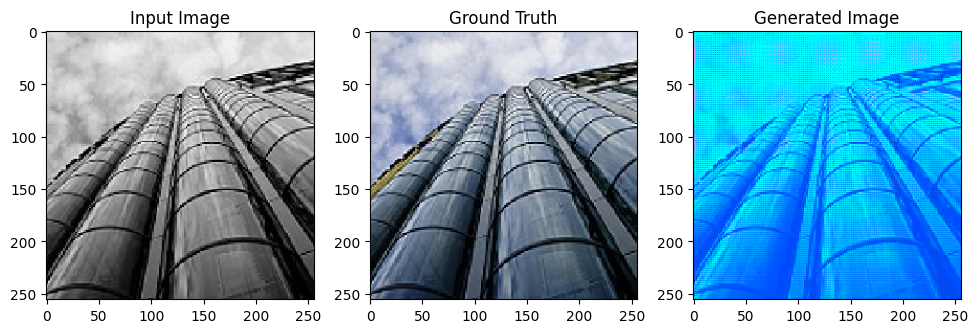

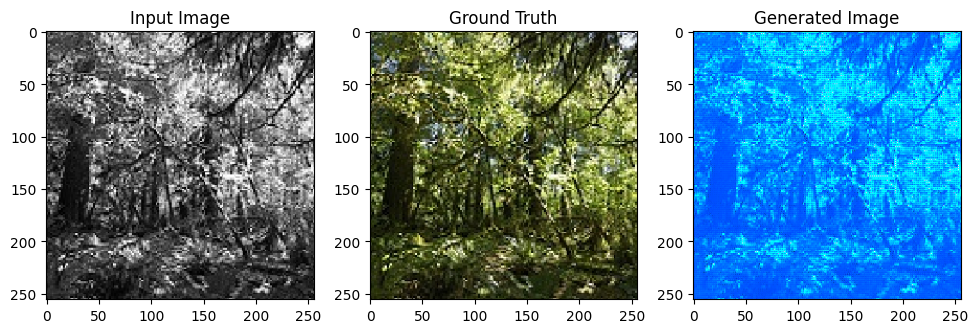

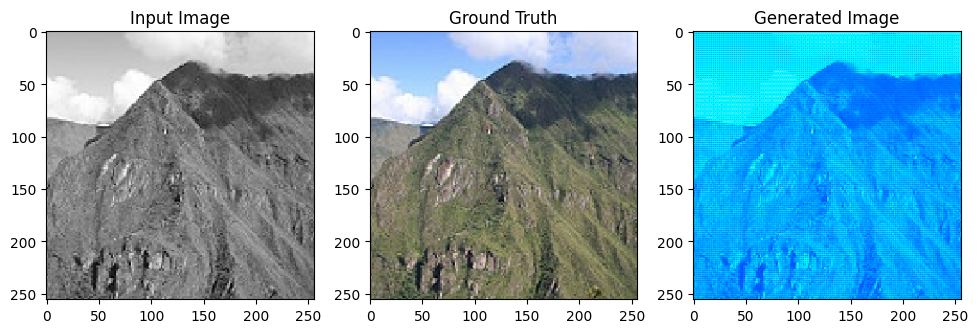

torch.Size([16, 1, 256, 256]) torch.Size([16, 2, 256, 256])


<Figure size 1500x1500 with 0 Axes>

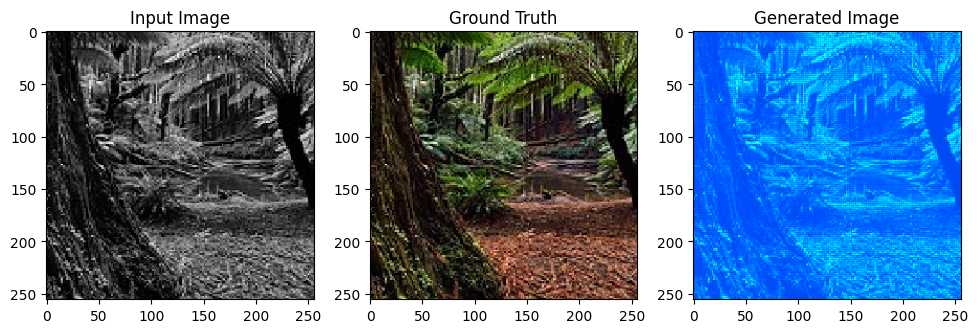

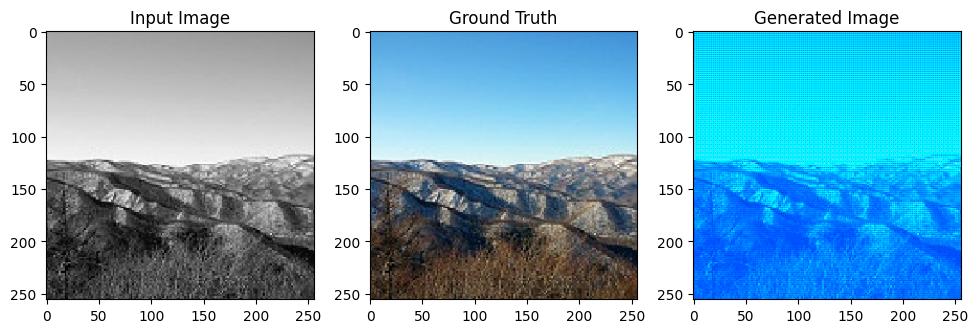

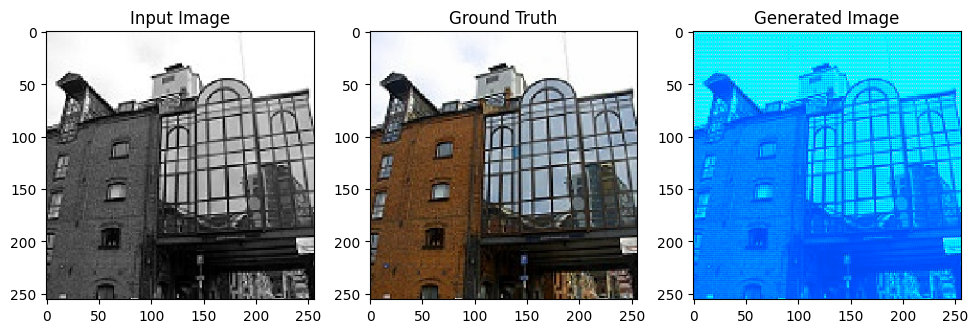

torch.Size([16, 1, 256, 256]) torch.Size([16, 2, 256, 256])


<Figure size 1500x1500 with 0 Axes>

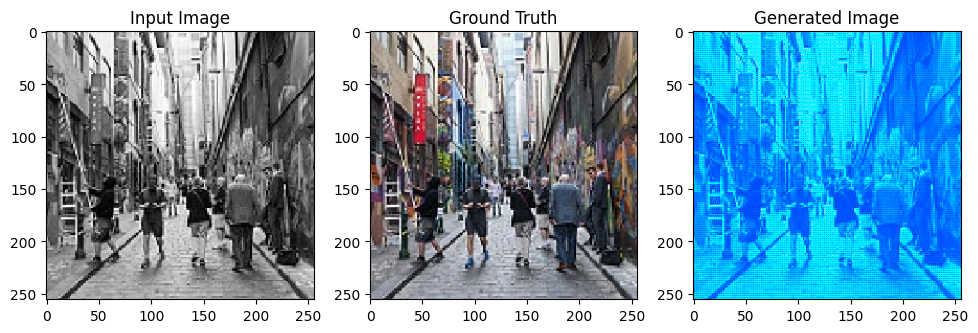

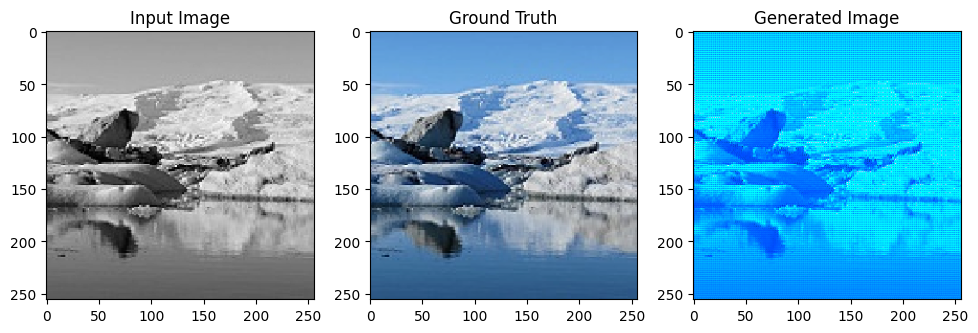

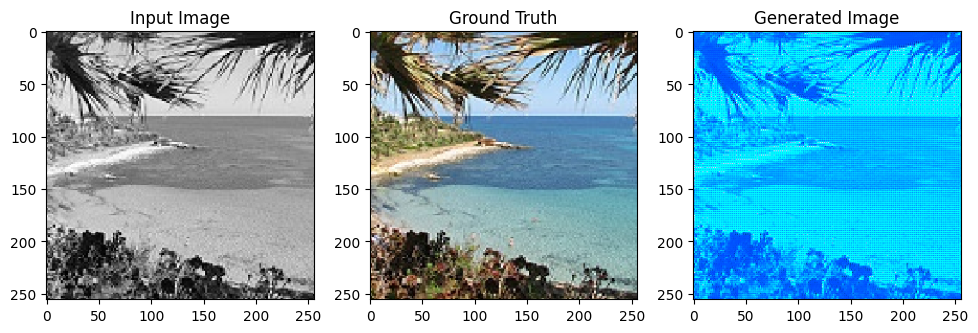

torch.Size([16, 1, 256, 256]) torch.Size([16, 2, 256, 256])


<Figure size 1500x1500 with 0 Axes>

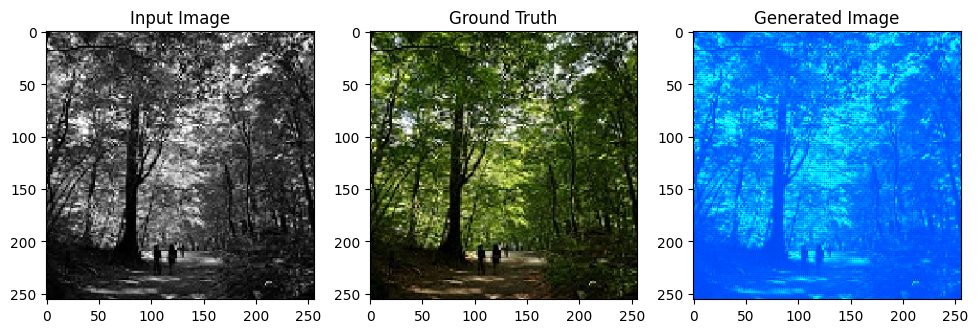

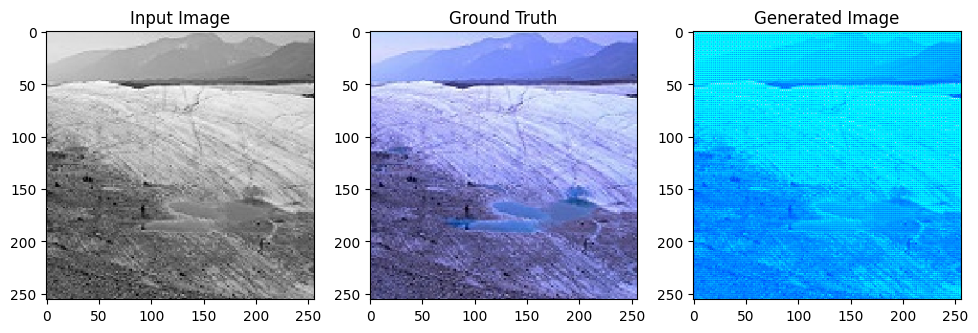

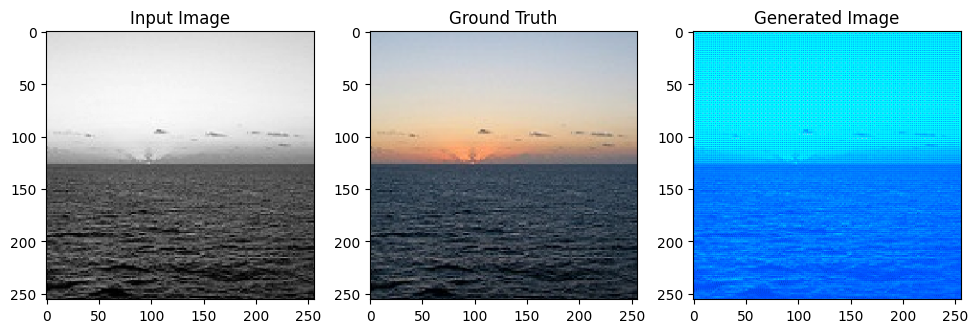

In [77]:
def generate_images(model, test_input, tar):
  model.eval()  # Set the model to evaluation mode
  with torch.no_grad():  # Temporarily set all the requires_grad flag to false
      prediction = model(test_input.to(device))

  plt.figure(figsize=(15,15))

  display_list = [tar[0], test_input[0],  prediction[0]]
  title = ['Ground Truth', 'Input Image', 'Predicted Image']

  for i in range(3):
    # input image
    fig = plt.figure(figsize=(16,16))
    plt.subplot(441)
    plt.imshow(L_images[i].permute(1,2,0),cmap='gray')
    plt.title('Input Image')

    # original coloured image
    plt.subplot(442)
    color_image = torch.cat((test_input[i], tar[i]), dim=0).permute(1,2,0)
    color_image = color_image.cpu() * torch.tensor([100,255,255]) - torch.tensor([0,128,128])
    color_image = lab2rgb(color_image)
    plt.imshow(color_image)
    plt.title('Ground Truth')

    # original coloured image
    plt.subplot(443)
    color_image = torch.cat((test_input[i], prediction[i]), dim=0).permute(1,2,0)
    color_image = color_image.cpu() * torch.tensor([100,255,255]) - torch.tensor([0,128,128])
    color_image = lab2rgb(color_image)
    plt.imshow(color_image)
    plt.title('Generated Image')

    # plt.subplot(1, 3, i+1)
    # plt.title(title[i])
    # # Getting the pixel values between [0, 1] to plot it.
    # plt.imshow(display_list[i].permute(1, 2, 0).cpu().numpy())
    # plt.axis('off')
  plt.show()

show_only = 5

for n, (L_images, ab_images) in enumerate(test_loader):
    print(L_images.shape, ab_images.shape)
    generate_images(generator, L_images.to(device), ab_images.to(device))
    if n >= show_only - 1:
        break

In [78]:
fit(train_loader, epochs = 50)

Epoch:  1


100%|██████████| 88/88 [00:41<00:00,  2.11it/s]


Generator total loss: 15.65380541302941
Discriminator loss: 1.0729216716506265
Time taken for epoch 1 is 41.7150137424469 sec

Epoch:  2


100%|██████████| 88/88 [00:44<00:00,  1.98it/s]


Generator total loss: 6.437047286467119
Discriminator loss: 1.0082487491044132
Time taken for epoch 2 is 44.34253478050232 sec

Epoch:  3


100%|██████████| 88/88 [00:46<00:00,  1.90it/s]


Generator total loss: 5.67113561521877
Discriminator loss: 1.0071560401808133
Time taken for epoch 3 is 46.27439212799072 sec

Epoch:  4


100%|██████████| 88/88 [00:47<00:00,  1.84it/s]


Generator total loss: 5.337462772022594
Discriminator loss: 1.006822419437495
Time taken for epoch 4 is 47.76268768310547 sec

Epoch:  5


100%|██████████| 88/88 [00:47<00:00,  1.86it/s]


Generator total loss: 5.138785405592485
Discriminator loss: 1.0066683278842405
Time taken for epoch 5 is 47.347387075424194 sec

Epoch:  6


100%|██████████| 88/88 [00:48<00:00,  1.80it/s]


Generator total loss: 5.030120743946596
Discriminator loss: 1.0066131786866621
Time taken for epoch 6 is 48.795257568359375 sec

Epoch:  7


100%|██████████| 88/88 [00:48<00:00,  1.82it/s]


Generator total loss: 4.853101407939738
Discriminator loss: 1.006575885144147
Time taken for epoch 7 is 48.235799074172974 sec

Epoch:  8


100%|██████████| 88/88 [00:48<00:00,  1.83it/s]


Generator total loss: 4.690736342560161
Discriminator loss: 1.0065243501554837
Time taken for epoch 8 is 48.08704090118408 sec

Epoch:  9


100%|██████████| 88/88 [00:46<00:00,  1.89it/s]


Generator total loss: 4.596066957170313
Discriminator loss: 1.0065083341165022
Time taken for epoch 9 is 46.54538369178772 sec

Epoch:  10


100%|██████████| 88/88 [00:46<00:00,  1.88it/s]


Generator total loss: 4.540393647822467
Discriminator loss: 1.0064952956004576
Time taken for epoch 10 is 46.76464295387268 sec

Epoch:  11


100%|██████████| 88/88 [00:46<00:00,  1.89it/s]


Generator total loss: 4.526450281793421
Discriminator loss: 1.0064793161370538
Time taken for epoch 11 is 46.447341442108154 sec

Epoch:  12


100%|██████████| 88/88 [00:46<00:00,  1.90it/s]


Generator total loss: 4.413518580523404
Discriminator loss: 1.0064715309576555
Time taken for epoch 12 is 46.35340619087219 sec

Epoch:  13


100%|██████████| 88/88 [00:45<00:00,  1.92it/s]


Generator total loss: 4.460378134792501
Discriminator loss: 1.1069021143696525
Time taken for epoch 13 is 45.90125823020935 sec

Epoch:  14


100%|██████████| 88/88 [00:45<00:00,  1.92it/s]


Generator total loss: 4.458310707048937
Discriminator loss: 1.0319586314938285
Time taken for epoch 14 is 45.81929016113281 sec

Epoch:  15


100%|██████████| 88/88 [00:45<00:00,  1.92it/s]


Generator total loss: 4.351344737139615
Discriminator loss: 1.0321663523262197
Time taken for epoch 15 is 45.79935169219971 sec

Epoch:  16


100%|██████████| 88/88 [00:45<00:00,  1.92it/s]


Generator total loss: 4.340856240554289
Discriminator loss: 1.0318290970542214
Time taken for epoch 16 is 45.82621908187866 sec

Epoch:  17


100%|██████████| 88/88 [00:45<00:00,  1.92it/s]


Generator total loss: 4.255930312655189
Discriminator loss: 1.0317916694012554
Time taken for epoch 17 is 45.797871351242065 sec

Epoch:  18


100%|██████████| 88/88 [00:45<00:00,  1.92it/s]


Generator total loss: 4.243645738471638
Discriminator loss: 1.0317922993139788
Time taken for epoch 18 is 45.7759222984314 sec

Epoch:  19


100%|██████████| 88/88 [00:45<00:00,  1.93it/s]


Generator total loss: 4.282809913158417
Discriminator loss: 1.0317639044739984
Time taken for epoch 19 is 45.69079351425171 sec

Epoch:  20


100%|██████████| 88/88 [00:45<00:00,  1.92it/s]


Generator total loss: 4.180919086391276
Discriminator loss: 1.031759026375684
Time taken for epoch 20 is 45.77155661582947 sec

Epoch:  21


100%|██████████| 88/88 [00:45<00:00,  1.92it/s]


Generator total loss: 4.187296561219475
Discriminator loss: 1.0317526988007806
Time taken for epoch 21 is 45.90838861465454 sec

Epoch:  22


100%|██████████| 88/88 [00:45<00:00,  1.93it/s]


Generator total loss: 4.104373043233698
Discriminator loss: 1.031748134981502
Time taken for epoch 22 is 45.65620303153992 sec

Epoch:  23


100%|██████████| 88/88 [00:45<00:00,  1.92it/s]


Generator total loss: 4.1342363791032275
Discriminator loss: 1.0317429954355413
Time taken for epoch 23 is 45.75689220428467 sec

Epoch:  24


100%|██████████| 88/88 [00:45<00:00,  1.92it/s]


Generator total loss: 4.127793190154162
Discriminator loss: 1.031813687898896
Time taken for epoch 24 is 45.741936445236206 sec

Epoch:  25


100%|██████████| 88/88 [00:45<00:00,  1.93it/s]


Generator total loss: 4.139353313229301
Discriminator loss: 1.0317577814513987
Time taken for epoch 25 is 45.69483757019043 sec

Epoch:  26


100%|██████████| 88/88 [00:45<00:00,  1.92it/s]


Generator total loss: 4.101676607673818
Discriminator loss: 1.0317481471733614
Time taken for epoch 26 is 45.81779503822327 sec

Epoch:  27


100%|██████████| 88/88 [00:45<00:00,  1.92it/s]


Generator total loss: 4.061200196092779
Discriminator loss: 1.0317439978772944
Time taken for epoch 27 is 45.80652642250061 sec

Epoch:  28


100%|██████████| 88/88 [00:45<00:00,  1.93it/s]


Generator total loss: 4.085926871408116
Discriminator loss: 1.0317422341216693
Time taken for epoch 28 is 45.705209493637085 sec

Epoch:  29


100%|██████████| 88/88 [00:45<00:00,  1.93it/s]


Generator total loss: 4.03638939965855
Discriminator loss: 1.031741826371713
Time taken for epoch 29 is 45.68596863746643 sec

Epoch:  30


100%|██████████| 88/88 [00:45<00:00,  1.93it/s]


Generator total loss: 3.995868452570655
Discriminator loss: 1.0317408415404232
Time taken for epoch 30 is 45.64769220352173 sec

Epoch:  31


100%|██████████| 88/88 [00:45<00:00,  1.92it/s]


Generator total loss: 3.939174077727578
Discriminator loss: 1.0317400192672557
Time taken for epoch 31 is 45.77946877479553 sec

Epoch:  32


100%|██████████| 88/88 [00:45<00:00,  1.92it/s]


Generator total loss: 4.052064976908944
Discriminator loss: 1.031764947555282
Time taken for epoch 32 is 45.85934138298035 sec

Epoch:  33


100%|██████████| 88/88 [00:45<00:00,  1.92it/s]


Generator total loss: 3.9285273877057163
Discriminator loss: 1.031743435697122
Time taken for epoch 33 is 45.90927338600159 sec

Epoch:  34


100%|██████████| 88/88 [00:45<00:00,  1.92it/s]


Generator total loss: 3.903645008802414
Discriminator loss: 1.0317406789823012
Time taken for epoch 34 is 45.846612215042114 sec

Epoch:  35


100%|██████████| 88/88 [00:45<00:00,  1.92it/s]


Generator total loss: 3.8481313694607127
Discriminator loss: 1.0317397971044888
Time taken for epoch 35 is 45.80647039413452 sec

Epoch:  36


100%|██████████| 88/88 [00:45<00:00,  1.92it/s]


Generator total loss: 3.871265072714199
Discriminator loss: 1.0317390574650331
Time taken for epoch 36 is 45.845662117004395 sec

Epoch:  37


100%|██████████| 88/88 [00:44<00:00,  1.97it/s]


Generator total loss: 3.8185069425539537
Discriminator loss: 1.0317387811162255
Time taken for epoch 37 is 44.580965995788574 sec

Epoch:  38


100%|██████████| 88/88 [00:46<00:00,  1.89it/s]


Generator total loss: 3.7171568301591007
Discriminator loss: 1.031738199970939
Time taken for epoch 38 is 46.50241541862488 sec

Epoch:  39


100%|██████████| 88/88 [00:46<00:00,  1.88it/s]


Generator total loss: 3.744346569884907
Discriminator loss: 1.0317379913546822
Time taken for epoch 39 is 46.79758262634277 sec

Epoch:  40


100%|██████████| 88/88 [00:46<00:00,  1.87it/s]


Generator total loss: 3.785021324049343
Discriminator loss: 1.0317372991280123
Time taken for epoch 40 is 46.97155976295471 sec

Epoch:  41


100%|██████████| 88/88 [00:47<00:00,  1.86it/s]


Generator total loss: 3.6098588813434946
Discriminator loss: 1.0317373113198713
Time taken for epoch 41 is 47.30059766769409 sec

Epoch:  42


100%|██████████| 88/88 [00:47<00:00,  1.85it/s]


Generator total loss: 3.7276640994982286
Discriminator loss: 1.031737052581527
Time taken for epoch 42 is 47.53210973739624 sec

Epoch:  43


100%|██████████| 88/88 [00:47<00:00,  1.87it/s]


Generator total loss: 3.5834424008022654
Discriminator loss: 1.0317368656396866
Time taken for epoch 43 is 47.171021938323975 sec

Epoch:  44


100%|██████████| 88/88 [00:47<00:00,  1.84it/s]


Generator total loss: 3.5572413449937645
Discriminator loss: 1.0317367694594644
Time taken for epoch 44 is 47.731362104415894 sec

Epoch:  45


100%|██████████| 88/88 [00:46<00:00,  1.87it/s]


Generator total loss: 3.51358868859031
Discriminator loss: 1.0317366881804033
Time taken for epoch 45 is 46.94833731651306 sec

Epoch:  46


100%|██████████| 88/88 [00:46<00:00,  1.87it/s]


Generator total loss: 3.454660028219223
Discriminator loss: 1.031736582517624
Time taken for epoch 46 is 46.95723009109497 sec

Epoch:  47


100%|██████████| 88/88 [00:46<00:00,  1.89it/s]


Generator total loss: 3.4790124893188477
Discriminator loss: 1.031736361709508
Time taken for epoch 47 is 46.607404708862305 sec

Epoch:  48


100%|██████████| 88/88 [00:46<00:00,  1.90it/s]


Generator total loss: 3.4268759218129246
Discriminator loss: 1.031736285849051
Time taken for epoch 48 is 46.42918086051941 sec

Epoch:  49


100%|██████████| 88/88 [00:46<00:00,  1.88it/s]


Generator total loss: 3.376435613090342
Discriminator loss: 1.0317362357269635
Time taken for epoch 49 is 46.85403394699097 sec

Epoch:  50


100%|██████████| 88/88 [00:46<00:00,  1.90it/s]

Generator total loss: 3.3550663861361416
Discriminator loss: 1.0317361558025533
Time taken for epoch 50 is 46.21564507484436 sec



torch.Size([16, 1, 256, 256]) torch.Size([16, 2, 256, 256])


C:\Users\chuag\AppData\Local\Temp\ipykernel_22564\3273462048.py:30: UserWarning: Conversion from CIE-LAB, via XYZ to sRGB color space resulted in 1 negative Z values that have been clipped to zero
  color_image = lab2rgb(color_image)


<Figure size 1500x1500 with 0 Axes>

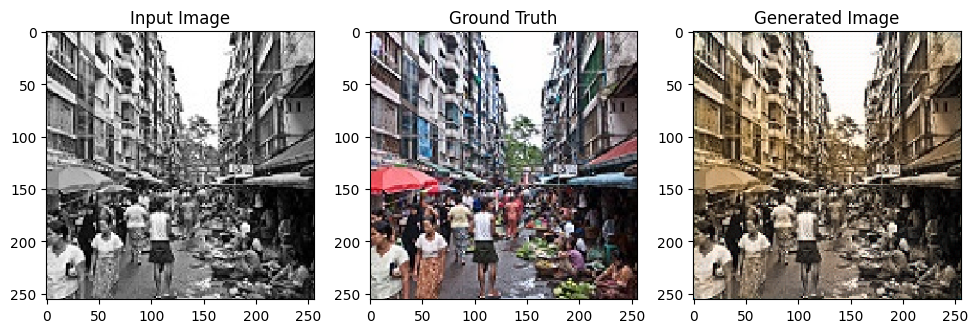

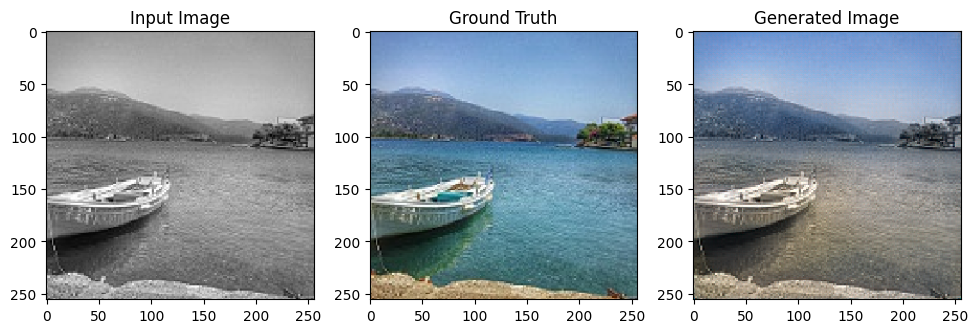

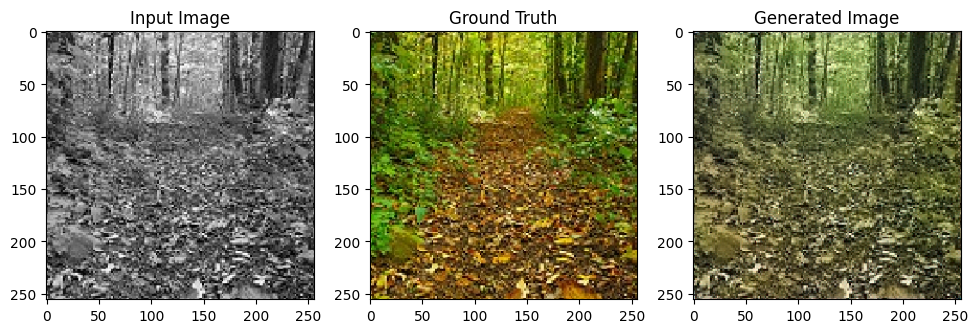

torch.Size([16, 1, 256, 256]) torch.Size([16, 2, 256, 256])


<Figure size 1500x1500 with 0 Axes>

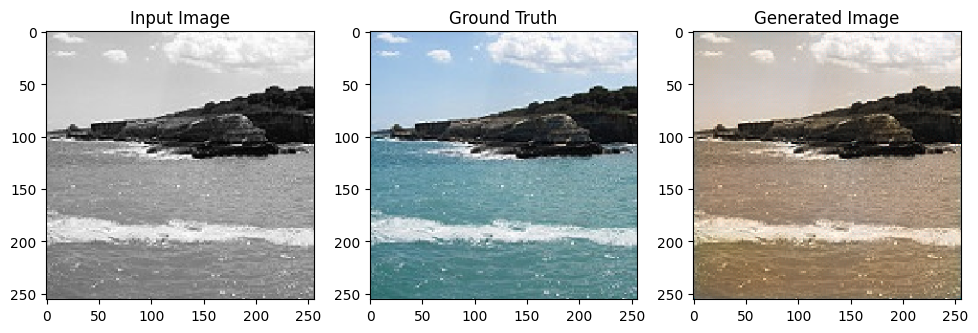

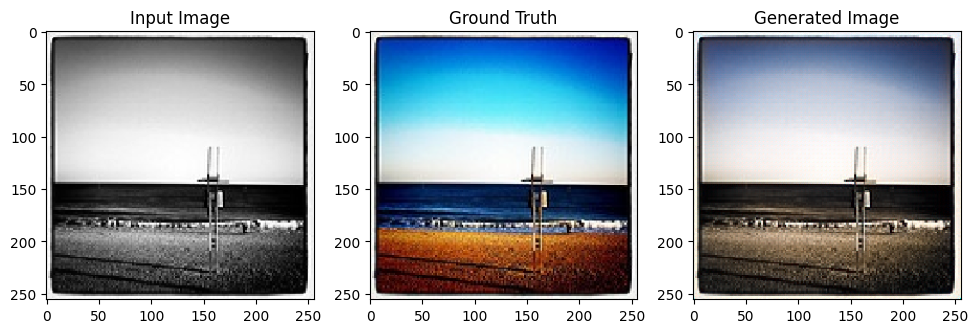

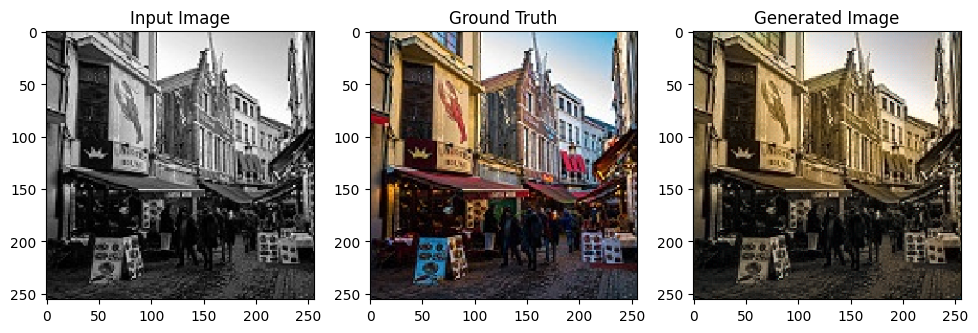

torch.Size([16, 1, 256, 256]) torch.Size([16, 2, 256, 256])


C:\Users\chuag\AppData\Local\Temp\ipykernel_22564\3273462048.py:30: UserWarning: Conversion from CIE-LAB, via XYZ to sRGB color space resulted in 27 negative Z values that have been clipped to zero
  color_image = lab2rgb(color_image)


<Figure size 1500x1500 with 0 Axes>

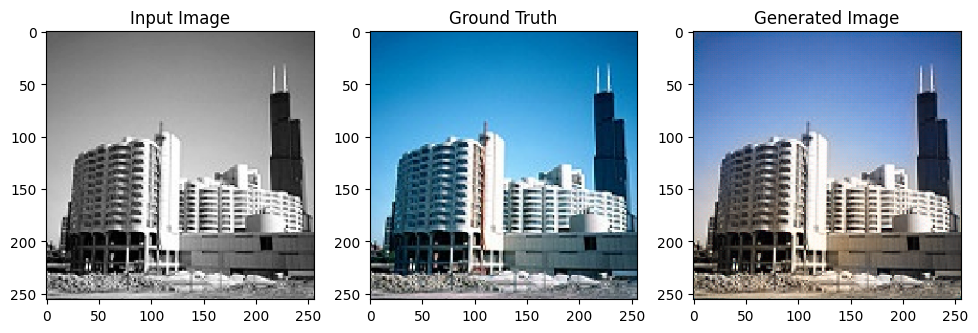

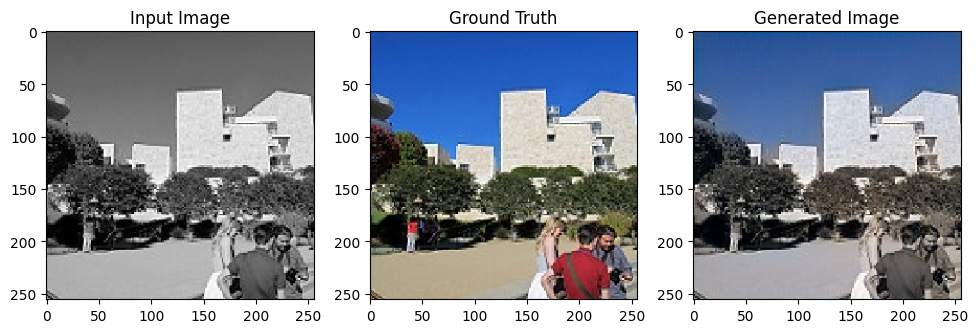

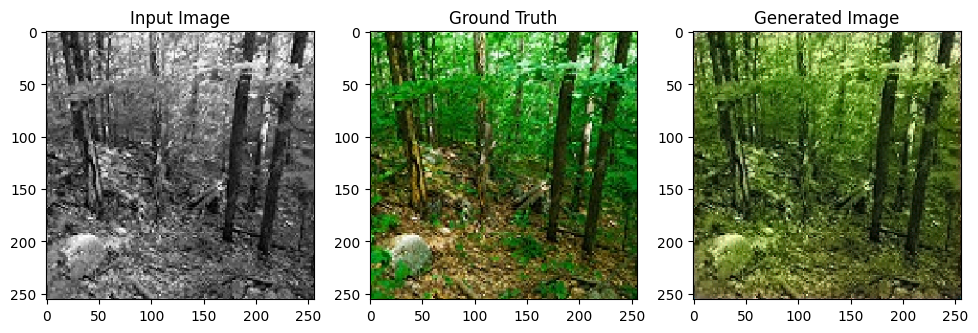

torch.Size([16, 1, 256, 256]) torch.Size([16, 2, 256, 256])


C:\Users\chuag\AppData\Local\Temp\ipykernel_22564\3273462048.py:30: UserWarning: Conversion from CIE-LAB, via XYZ to sRGB color space resulted in 9 negative Z values that have been clipped to zero
  color_image = lab2rgb(color_image)


<Figure size 1500x1500 with 0 Axes>

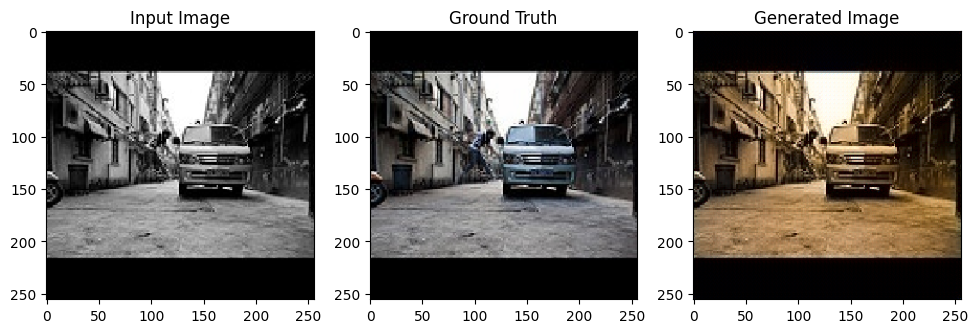

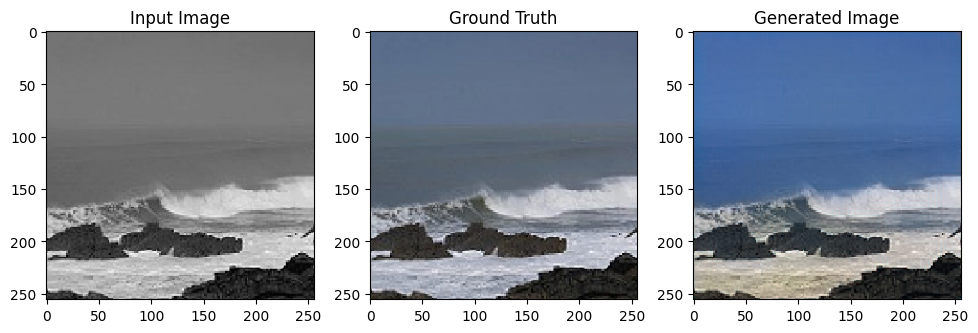

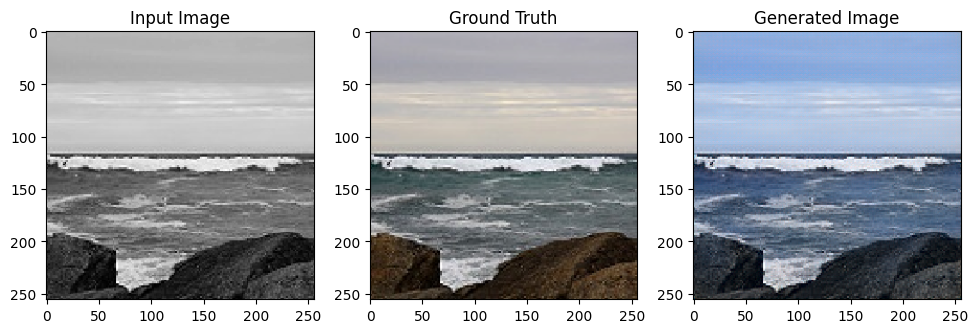

torch.Size([16, 1, 256, 256]) torch.Size([16, 2, 256, 256])


<Figure size 1500x1500 with 0 Axes>

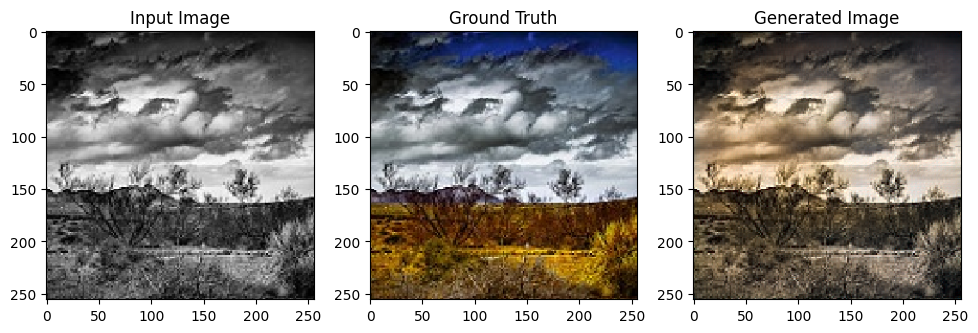

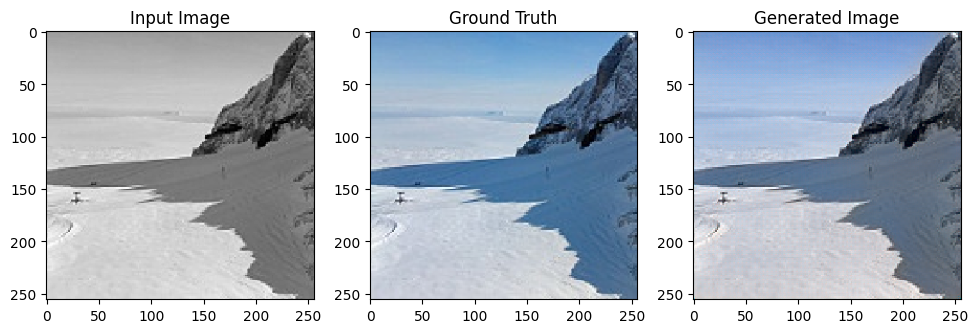

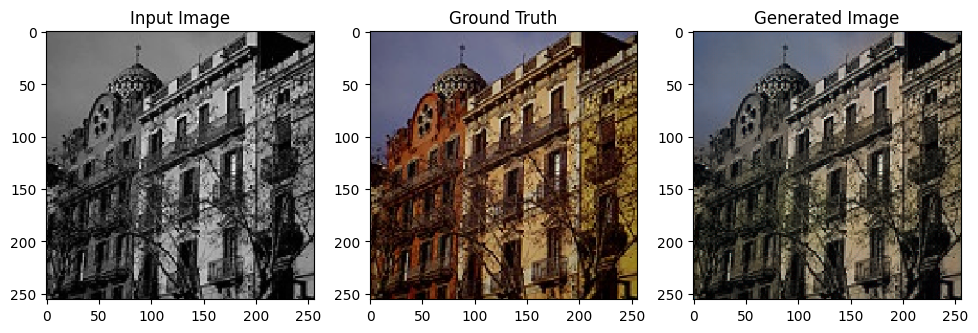

torch.Size([16, 1, 256, 256]) torch.Size([16, 2, 256, 256])


<Figure size 1500x1500 with 0 Axes>

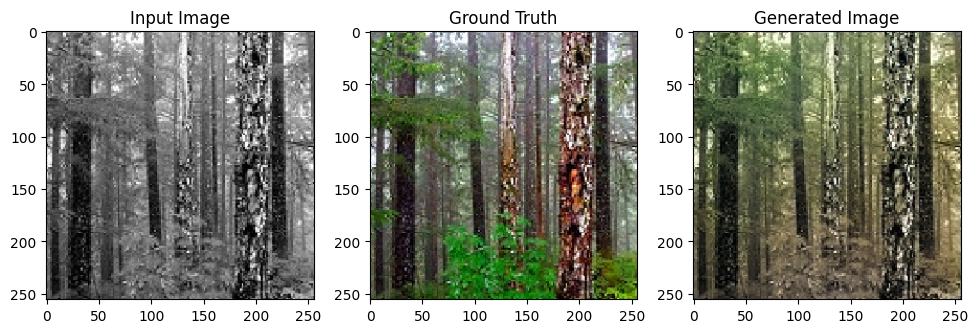

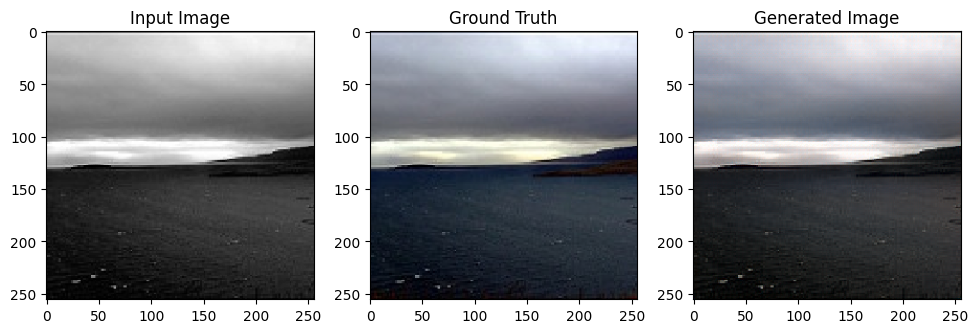

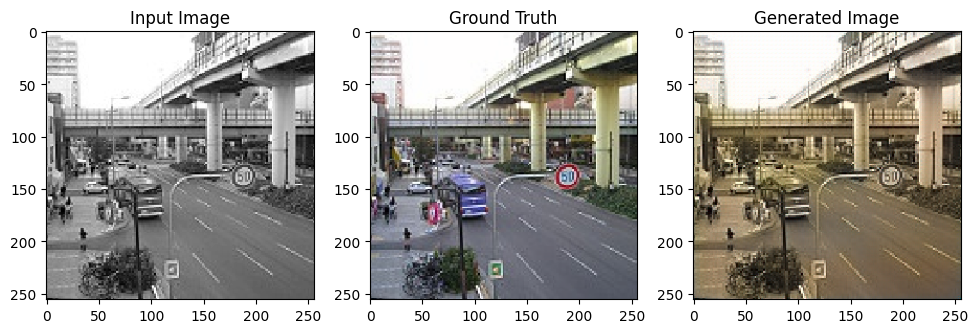

torch.Size([16, 1, 256, 256]) torch.Size([16, 2, 256, 256])


<Figure size 1500x1500 with 0 Axes>

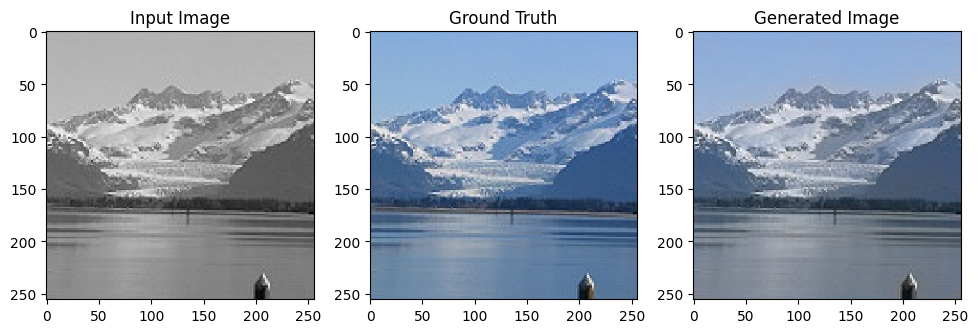

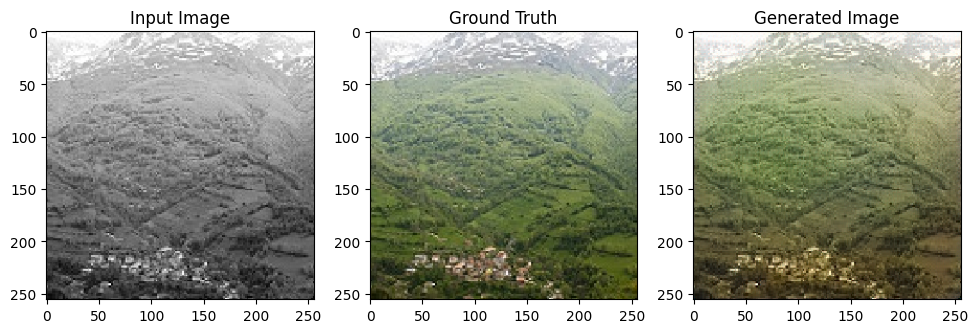

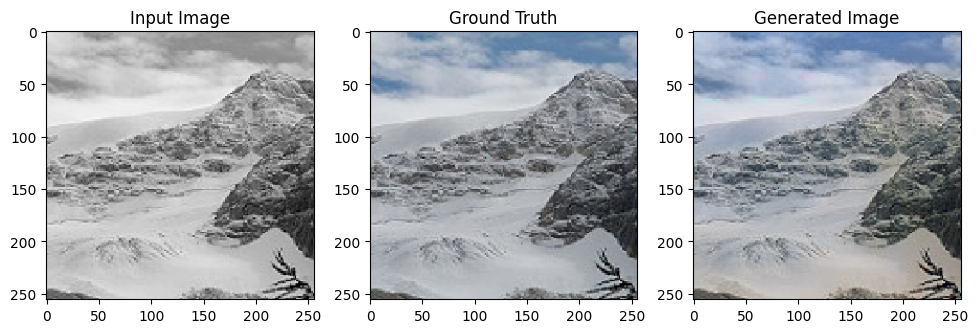

torch.Size([16, 1, 256, 256]) torch.Size([16, 2, 256, 256])


<Figure size 1500x1500 with 0 Axes>

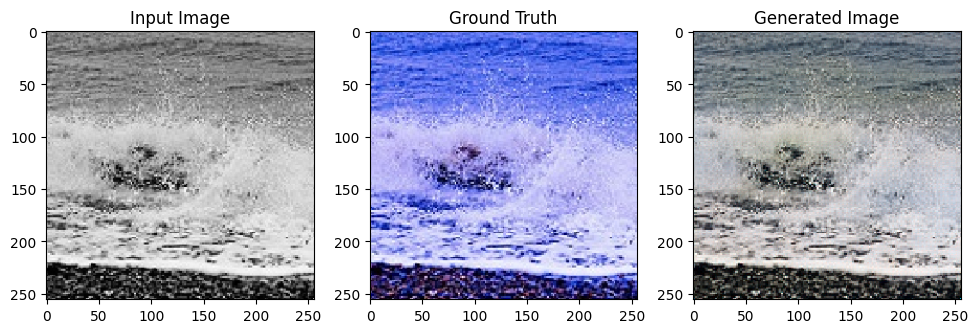

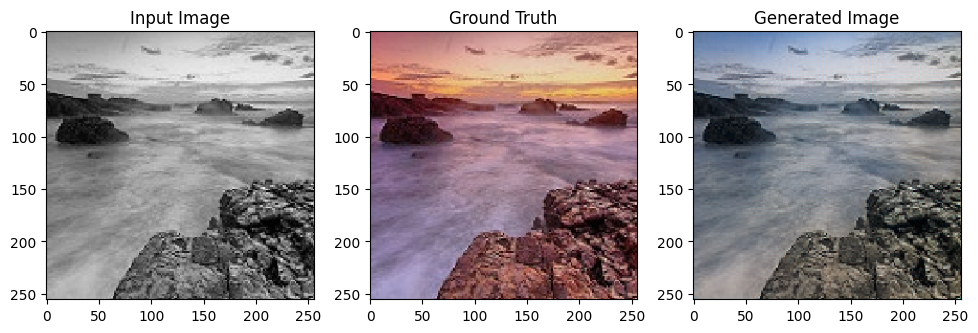

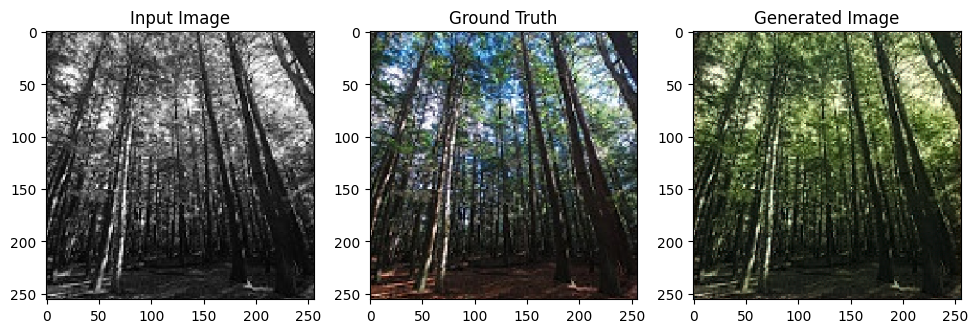

torch.Size([16, 1, 256, 256]) torch.Size([16, 2, 256, 256])


<Figure size 1500x1500 with 0 Axes>

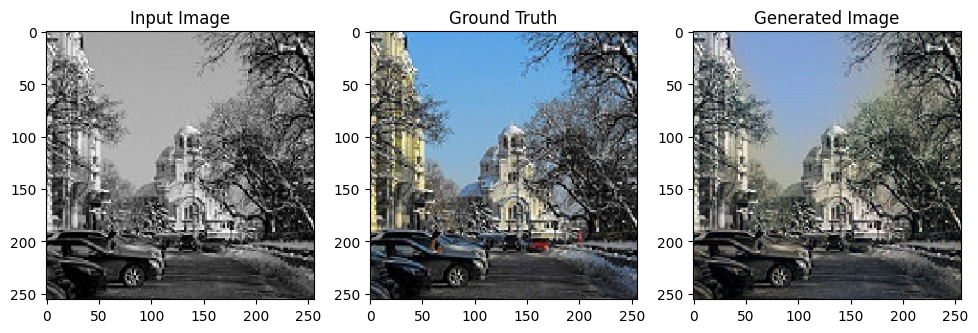

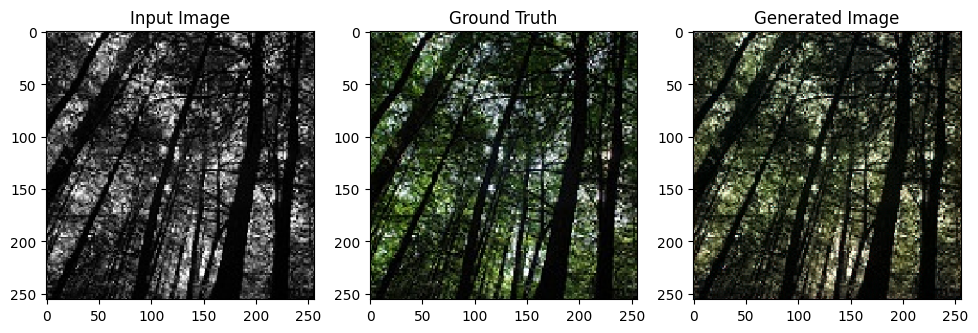

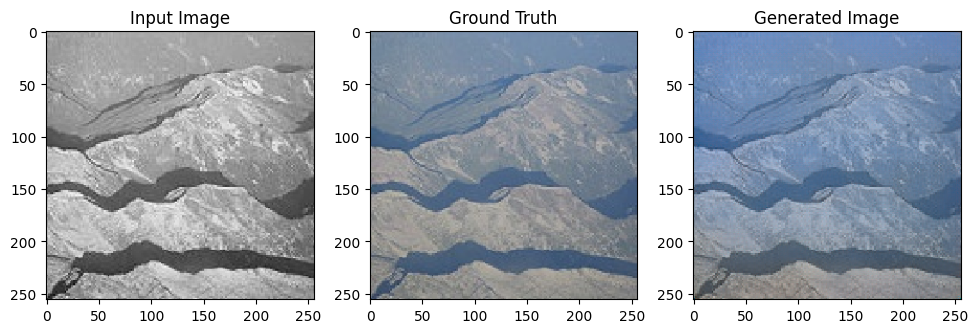

torch.Size([16, 1, 256, 256]) torch.Size([16, 2, 256, 256])


<Figure size 1500x1500 with 0 Axes>

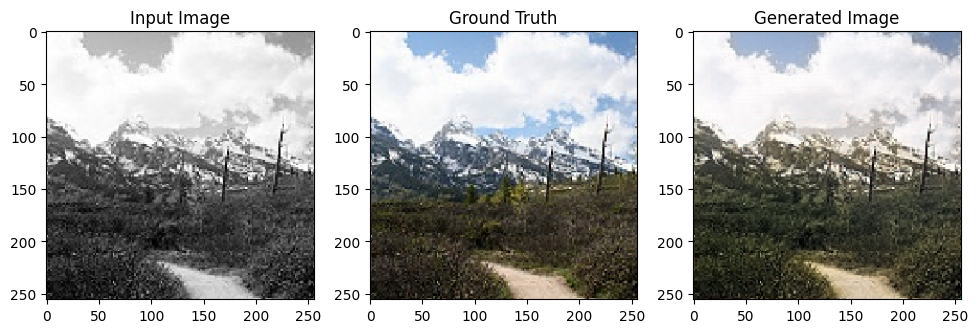

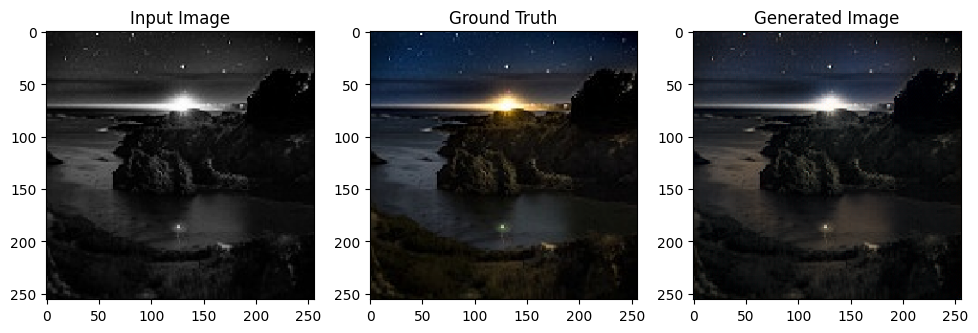

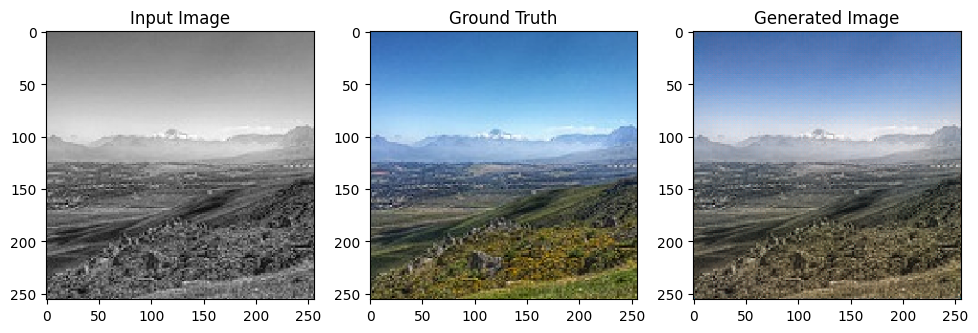

In [81]:
show_only = 10

for n, (L_images, ab_images) in enumerate(test_loader):
    print(L_images.shape, ab_images.shape)
    generate_images(generator, L_images.to(device), ab_images.to(device))
    if n >= show_only - 1:
        break